## Семинар 7 – Анализируем посты

Всем привет! 

Наше новое занятие посвящено разным способам предобработки текстов для дальнейшего анализа или обучения моделей машинного обучения, а также мы немного поисследуем собранные раннее посты из инстаграма РБК.

Обратите внимание, я беру датасет на 2700 постов (а не на 200, как было на семинаре 5), немного изменила формат, в котором мы сохраняем дату и добавила ссылки – используйте датасет, который лежит именно в этой папке.

*Материал подготовила Максимовская Анастасия, по всем вопросам пишите в телеграм @anastasiyamaxx*

<img src="https://static.javatpoint.com/tutorial/data-mining/images/text-data-mining3.png" width=500>

In [1]:
import pandas as pd

In [2]:
df = pd.read_csv('rbc_df.csv')
df.head()

,date,comments,likes,text,url
0,10/11/2021 16:11:33,25,1812,Переговоры — это столкновение двух и более про...,https://www.instagram.com/p/CWGgCllIUjK/
1,10/11/2021 11:10:42,327,2338,"У белорусско-польской границы мигранты, в боль...",https://www.instagram.com/p/CWF9nA6opvy/
2,09/11/2021 16:52:42,83,4252,Большинство из нас слышали про необходимость п...,https://www.instagram.com/p/CWD_9EHIf_K/
3,09/11/2021 13:29:03,27,1500,"Покупка мужского костюма — интересный процесс,...",https://www.instagram.com/p/CWDophIN18s/
4,08/11/2021 15:45:42,44,2214,Предприниматели грядущих десятилетий будут отл...,https://www.instagram.com/p/CWBTfdnISbq/


Убедимся, что все в колонке с текстом все имеет тип str:

In [3]:
df['text'] = df['text'].astype(str)

## Маленький разведочный анализ данных (EDA, exploratory data analysis)

Средние больше медиан – значит, есть несколько выбросов (постов, которые набрали сильно больше лайков и комментов, чем большинство).

In [4]:
df.shape

(2711, 5)

In [5]:
df.describe()

,comments,likes
count,2711.000000,2711.000000
mean,131.238657,2163.443379
std,203.748409,2728.772495
min,0.000000,4.000000
25%,14.000000,352.000000
50%,55.000000,1302.000000
75%,160.000000,2923.500000
max,2458.000000,24298.000000


In [9]:
df.describe(include=['object'])

,date,text,url
count,2711,2711,2711
unique,2711,2438,2711
top,10/11/2021 16:11:33,ЧЭЗ Next - ежедневный информационный марафон в...,https://www.instagram.com/p/CWGgCllIUjK/
freq,1,224,1


Посмотрим на них:

In [11]:
df.sort_values('likes', ascending=False)[:10]

,date,comments,likes,text,url
227,13/08/2021 12:58:46,1023,24298,Приносят ли деньги счастье? Фундаментальный во...,https://www.instagram.com/p/CSg_JurnvHJ/
118,24/09/2021 08:31:30,1416,22825,"Утром 23 сентября группа из 23 человек, состоя...",https://www.instagram.com/p/CUMqB4RAmDA/
224,14/08/2021 09:30:27,677,22356,Создатель розничной сети «Магнит» Сергей Галиц...,https://www.instagram.com/p/CSjML2LD35u/
1461,02/04/2020 17:16:50,633,21599,Денис Проценко опубликовал на своей страницы в...,https://www.instagram.com/p/B-fI5AxFpoR/
271,29/07/2021 21:02:22,205,21474,💪,https://www.instagram.com/p/CR7OpjqLRZ5/
128,21/09/2021 06:33:18,1088,20517,"Правда ли зумеры охладели к сексу, позже женят...",https://www.instagram.com/p/CUEuHm3AOWg/
281,27/07/2021 07:33:37,499,20116,😍,https://www.instagram.com/p/CR0ogVIHgRm/
278,27/07/2021 16:48:37,446,18965,В четвертый игровой день на Олимпиаде в Токио ...,https://www.instagram.com/p/CR1oBUcJUpB/
77,10/10/2021 07:10:59,199,18716,Основатель ВКонтакте и Telegram Павел Дуров пр...,https://www.instagram.com/p/CU1tiLYImZ_/
692,27/03/2021 08:03:29,537,17779,Российская фигуристка 16-летняя Анна Щербакова...,https://www.instagram.com/p/CM6i8UylnTo/


В первые 10 постов по количеству лайков вошли несколько размышлений бизнесменов о карьере и успехе (Андрей Трубников, Сергей Галицкий, Павел Дуров), вдохновляющие истории (туристы, выжившие на Эльбрусе, благодарность врачам) и несколько новостей про победы в спорте.

Посмотрим на гистограмму распределения лайков:

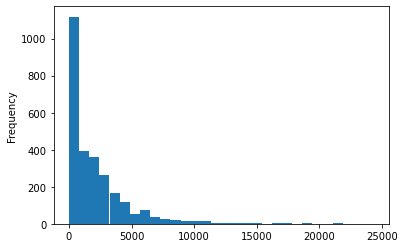

In [15]:
df['likes'].plot.hist(bins=30);

На данной гистограмме отмечается частота попадений значений в 30 заданных интервалов. Видно, что у большой части постов лайков не очень много. Проверим, сколько их.

In [20]:
df[df['likes'] < 814].shape[0]

1118

У 1118 постов меньше, чем 810 лайков. При этом есть ряд постов, у которых более 20000 лайков.

Посмотрим, как лайки зависят от времени публикации.

In [23]:
df.head()

,date,comments,likes,text,url,hour
0,2021-10-11 16:11:33,25,1812,Переговоры — это столкновение двух и более про...,https://www.instagram.com/p/CWGgCllIUjK/,16
1,2021-10-11 11:10:42,327,2338,"У белорусско-польской границы мигранты, в боль...",https://www.instagram.com/p/CWF9nA6opvy/,11
2,2021-09-11 16:52:42,83,4252,Большинство из нас слышали про необходимость п...,https://www.instagram.com/p/CWD_9EHIf_K/,16
3,2021-09-11 13:29:03,27,1500,"Покупка мужского костюма — интересный процесс,...",https://www.instagram.com/p/CWDophIN18s/,13
4,2021-08-11 15:45:42,44,2214,Предприниматели грядущих десятилетий будут отл...,https://www.instagram.com/p/CWBTfdnISbq/,15


In [17]:
df['date'] = pd.to_datetime(df['date'])

In [22]:
df['hour'] = df['date'].dt.hour

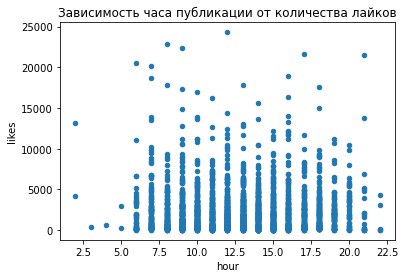

In [25]:
df.plot(x='hour', y='likes', kind='scatter',
       title='Зависимость часа публикации от количества лайков');

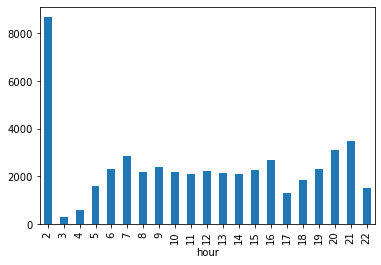

In [28]:
df.groupby('hour')['likes'].mean().plot(kind='bar');

In [31]:
df[df['hour'] == 2]

,date,comments,likes,text,url,hour
90,2021-05-10 02:19:19,873,13201,Состояние основателя Facebook Марка Цукерберга...,https://www.instagram.com/p/CUoULinIdW7/,2
504,2021-05-23 02:04:47,473,4168,Представляющая Россию певица Manizha заняла де...,https://www.instagram.com/p/CPMrM-7FYH0/,2


In [53]:
df[df['hour'] == 12].shape

(262, 6)

In [35]:
df[df['hour'] == 12]

,date,comments,likes,text,url,hour
8,2021-06-11 12:06:56,550,3274,В Коста-Рике детей в возрасте от 5 до 11 лет б...,https://www.instagram.com/p/CV7w3ajIwAd/,12
12,2021-04-11 12:38:54,60,4057,В 1979 году Сергей Брин переехал из СССР в США...,https://www.instagram.com/p/CV2q7wLoA8e/,12
19,2021-02-11 12:47:43,64,6266,С вечера понедельника Москву окутал плотный ту...,https://www.instagram.com/p/CVxiWqyIgyO/,12
27,2021-10-30 12:30:31,233,2622,В 2020 году 60% россиян отрицательно относилис...,https://www.instagram.com/p/CVpx_9fotZ6/,12
30,2021-10-29 12:47:12,67,4025,"Компания Facebook, которой принадлежат одноиме...",https://www.instagram.com/p/CVnPHVbo9LE/,12
...,...,...,...,...,...,...
2646,2017-01-09 12:21:20,0,44,"«Для танго нужны двое, а США исполняют индивид...",https://www.instagram.com/p/BYf4qvDjXYM/,12
2680,2016-04-23 12:36:56,1,35,«Я хотел кардинально изменить жизнь». Бывший г...,https://www.instagram.com/p/BEiwLBIFF9Q/,12
2685,2016-06-04 12:27:12,1,12,"Федор Аптекарев, основатель компании Здравприн...",https://www.instagram.com/p/BD29i1ZlF3o/,12
2691,2016-03-29 12:00:38,3,12,"Аркадий Ротенберг, бизнесмен. Екатерина Кузьми...",https://www.instagram.com/p/BDiUJOcFF0f/,12


Какой-то очевидной зависимости не наблюдается. 

## Облако слов

Облако слов удобно для красивой и наглядной презентации слов, которые наиболее часто встречаются в тексте. Для его построения установим библиотеку wordcloud. 

In [37]:
# !pip install wordcloud

In [38]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [40]:
# ?WordCloud

Нарисуем облако слов для одного поста:

In [41]:
text = df['text'][2000]

text

'В декабре 2018 года россияне оформили больше микрокредитов на подарки близким, чем за аналогичный период годом ранее, подсчитали в SmartCredit. Рост микрокредитования зафиксирован более чем в 80 регионах. По данным МФО, чаще других (44,6%) заемные средства на подарки используют люди в возрасте до 30 лет. Из общего «новогоднего бюджета» (в среднем в 2018-м эта сумма составляет ₽16,9 тыс.) на подарки планируется направить 42%. Активнее всего покупатели берут займы на популярные гаджеты.\n⠀\nКроме того, россияне поставили новый рекорд на рынке ипотеки: в ноябре банки выдали кредитов на ₽300 млрд руб. Ажиотаж вызван планируемым повышением ставок. В декабре кредитов может быть выдано еще больше, ожидают эксперты.\n\n#рбк #rbc #rbcновости #россия #новыйгод #праздник #статистика #москва #подарки #новыйгод #праздниккнамприходит #доход #зарплата #ипотека'

In [42]:
wordcloud = WordCloud().generate(text)
wordcloud

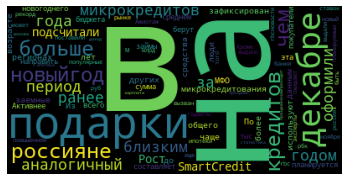

In [44]:
plt.imshow(wordcloud) # отрисовывает картинку
plt.axis("off") # убирает оси и подписи к ним
plt.show()

Нарисуем облако слов для всех постов:

In [47]:
'*'.join(['1', '2', '3'])

'1*2*3'

In [49]:
text = " ".join(df['text'].to_list())
print ("Во всех собранных постах суммарно содержится {} слов.".format(len(text.split())))

Во всех собранных постах суммарно содержится 172473 слов.


In [50]:
wordcloud = WordCloud(background_color="white").generate(text)

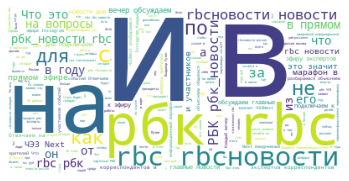

In [51]:
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

Мы столкнулись с необходимостью предобратки сырого текста. Как видите, самые частые слова – это предлоги "на", "и", "в". Они не несут никакого глубокого смысла и никак не помогают нашему анализу текстов. Такие слова называются стоп-словами. Как правило, первый шаг в работе с текстом – это очищение его от пунктуации и стоп-слов.

Перед тем, как начать работать с текстом, удалим посты, где описания состоят из эмодзи.

In [52]:
df = df[df['text'].apply(len) > 5]

In [51]:
df['text'].apply(len)

0       314
1       406
2       251
3       280
4       273
       ... 
2706     76
2707     63
2708     72
2709     99
2710     94
Name: text, Length: 2688, dtype: int64

## Стоп-слова и пунктуация

**Стоп-слова** - это слова, которые часто встречаются практически в любом тексте и ничего интересного не говорят о конретном документе. Для модели это просто шум. А шум нужно убирать. По аналогичной причине убирают и пунктуацию.

In [54]:
# импортируем стоп-слова из библиотеки nltk
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

# посмотрим на стоп-слова для русского языка
print(stopwords.words('russian'))

['и', 'в', 'во', 'не', 'что', 'он', 'на', 'я', 'с', 'со', 'как', 'а', 'то', 'все', 'она', 'так', 'его', 'но', 'да', 'ты', 'к', 'у', 'же', 'вы', 'за', 'бы', 'по', 'только', 'ее', 'мне', 'было', 'вот', 'от', 'меня', 'еще', 'нет', 'о', 'из', 'ему', 'теперь', 'когда', 'даже', 'ну', 'вдруг', 'ли', 'если', 'уже', 'или', 'ни', 'быть', 'был', 'него', 'до', 'вас', 'нибудь', 'опять', 'уж', 'вам', 'ведь', 'там', 'потом', 'себя', 'ничего', 'ей', 'может', 'они', 'тут', 'где', 'есть', 'надо', 'ней', 'для', 'мы', 'тебя', 'их', 'чем', 'была', 'сам', 'чтоб', 'без', 'будто', 'чего', 'раз', 'тоже', 'себе', 'под', 'будет', 'ж', 'тогда', 'кто', 'этот', 'того', 'потому', 'этого', 'какой', 'совсем', 'ним', 'здесь', 'этом', 'один', 'почти', 'мой', 'тем', 'чтобы', 'нее', 'сейчас', 'были', 'куда', 'зачем', 'всех', 'никогда', 'можно', 'при', 'наконец', 'два', 'об', 'другой', 'хоть', 'после', 'над', 'больше', 'тот', 'через', 'эти', 'нас', 'про', 'всего', 'них', 'какая', 'много', 'разве', 'три', 'эту', 'моя', 'впр

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/a18509896/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


*Знаки* пунктуации лучше импортировать из модуля **String**. В нем хранятся различные наборы констант для работы со строками (пунктуация, алфавит и др.). 

In [55]:
from string import punctuation
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

Объединим стоп-слова и знаки пунктуации вместе и запишем в переменную ```noise```:

In [56]:
noise = stopwords.words('russian') + list(punctuation)

In [57]:
noise[:10]

['и', 'в', 'во', 'не', 'что', 'он', 'на', 'я', 'с', 'со']

Удалить стоп-слова можно вручную. Например, так:

In [58]:
text = df['text'][10]
text

'Давно хотели поменять направление в работе, но все никак не решались? Переходите по ссылке в шапке профиля и читайте полезные рекомендации от РБК Pro. Эксперты по рекрутингу, профессиональному росту и развитию команд делятся карьерными советами, которые помогут получить «работу мечты».'

In [70]:
punctuation = '!"#$%&\'()*+,./:;<=>?@[\\]^_`{|}~«»'

In [74]:
# удаляем пунктуацию
no_punct_text = ''.join([s for s in text if s not in punctuation])
# удаляем стоп-слова
clean_text = [word for word in no_punct_text.lower().split() if word not in noise]
' '.join(clean_text)

'давно хотели поменять направление работе никак решались переходите ссылке шапке профиля читайте полезные рекомендации рбк pro эксперты рекрутингу профессиональному росту развитию команд делятся карьерными советами которые помогут получить работу мечты'

In [75]:
def remove_stopwords(text):
    no_punct_text = ''.join([s for s in text if s not in punctuation])
    clean_text = [word for word in no_punct_text.lower().split()
                  if word not in noise]
    return ' '.join(clean_text)

In [78]:
df['text_no_stopwords'] = df['text'].apply(remove_stopwords)

<ipython-input-78-9d2bbec711e0>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text_no_stopwords'] = df['text'].apply(remove_stopwords)


Отрисуем заново облако слов:

In [79]:
text = " ".join(df['text_no_stopwords'].to_list())

In [80]:
wordcloud = WordCloud(background_color="white", 
                     ).generate(text)

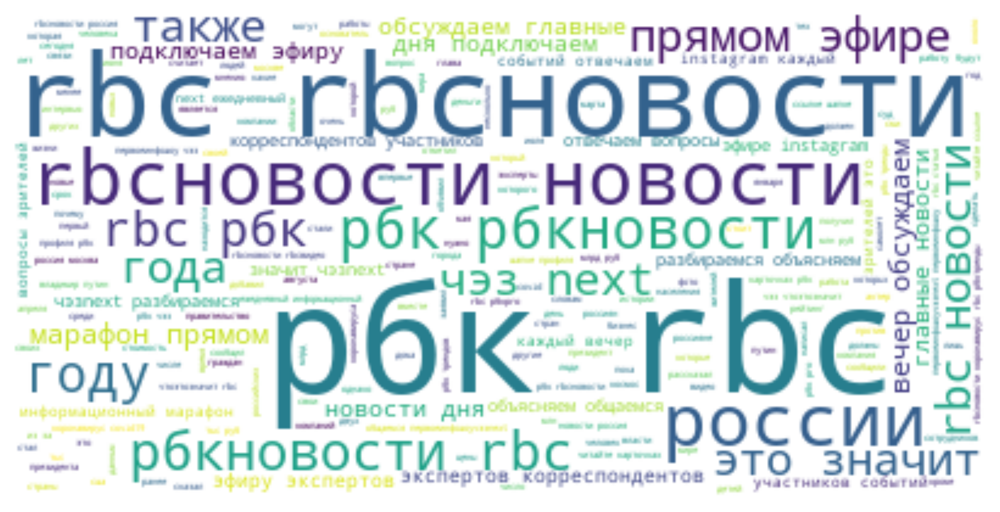

In [81]:
plt.figure(figsize=[10,7], dpi=1200)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [82]:
wordcloud.to_file("wordcloud_rbc.png")

Однако, можно было поступить и проще, просто передав список стоп-слов соответствующему аргументу wordcloud.

In [83]:
df['text'] = df['text'].apply(lambda x: x.lower())

<ipython-input-83-98777302f801>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'] = df['text'].apply(lambda x: x.lower())


In [84]:
text = " ".join(df['text'].to_list())

In [85]:
wordcloud = WordCloud(stopwords=noise, background_color="white").generate(text)

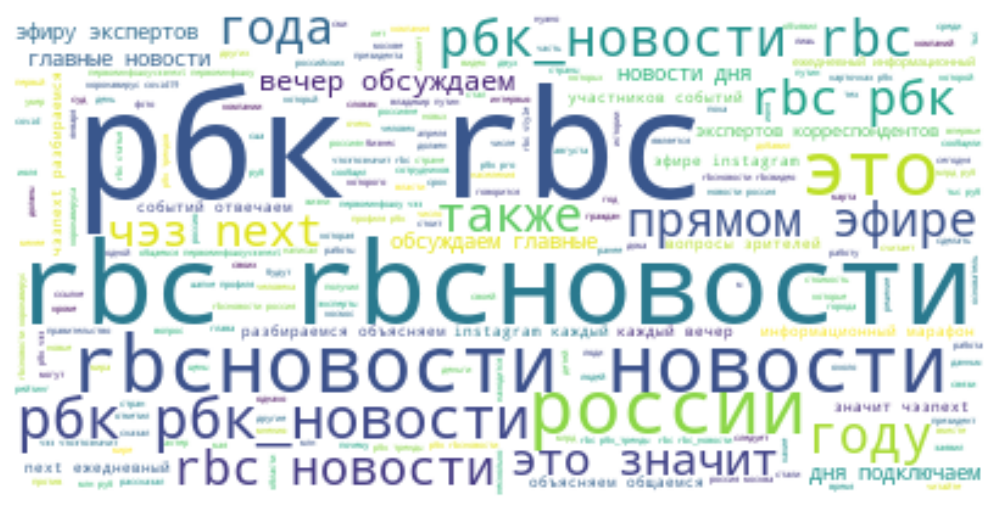

In [86]:
plt.figure(figsize=[10,7], dpi=1200)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

У многих методов для работы с текстами есть похожий аргумент. 

Мы замечаем еще одну интересную особенность – несколько раз повторяются одно и то же слово РБК, написанное по разному. Такие случаи можно убирать вручную (заменить все варианты написания слова на какой-то один). 

Для обычных слов такой процесс называется лемматизацией. Мы приводим все слова к нормальной форме, чтобы учитывать одно слово один раз, а не несколько, как будет в ситуации, если слово написано по-разному. Например, слова "сидели", "сидела", "сидел" заменим на "сидеть".

## Лемматизация

Еще один важный этап предобработки текста.

**Лемматизация** – это сведение разных форм одного слова к начальной форме – **лемме**. Почему это хорошо?
* Во-первых, естественно рассматривать как отдельный признак каждое *слово*, а не каждую его отдельную форму.
* Во-вторых, некоторые стоп-слова стоят только в начальной форме, и без лематизации выкидываем мы только её.

Для русского есть хороший лемматизатор pymorphy. 

[Pymorphy](http://pymorphy2.readthedocs.io/en/latest/) это модуль на питоне, довольно быстрый и с кучей функций.

In [75]:
# устанавливаем pymorphy2
!pip install pymorphy2

В pymorphy2 для морфологического анализа слов есть ```MorphAnalyzer()```:

In [87]:
from pymorphy2 import MorphAnalyzer
pymorphy2_analyzer = MorphAnalyzer()

pymorphy2 работает с отдельными словами. Если дать ему на вход предложение - он его просто не лемматизирует, т.к. не понимает:

In [88]:
sent = ['Если', 'б', 'мне', 'платили', 'каждый', 'раз']
sent

['Если', 'б', 'мне', 'платили', 'каждый', 'раз']

Лемматизируем слово "платили" из предложения ```sent``` с помощью метода ```parse()```:

In [89]:
ana = pymorphy2_analyzer.parse(sent[3])
ana

[Parse(word='платили', tag=OpencorporaTag('VERB,impf,tran plur,past,indc'), normal_form='платить', score=1.0, methods_stack=((DictionaryAnalyzer(), 'платили', 2472, 10),))]

Выведем его нормальную форму:

In [91]:
ana[0].normal_form

'платить'

Метод `MorphAnalyzer.parse()` принимает слово (обязательно в нижнем регистре) и возвращает все возможные разборы слова:

In [92]:
pymorphy2_analyzer.parse('стали')

[Parse(word='стали', tag=OpencorporaTag('VERB,perf,intr plur,past,indc'), normal_form='стать', score=0.975342, methods_stack=((DictionaryAnalyzer(), 'стали', 945, 4),)),
 Parse(word='стали', tag=OpencorporaTag('NOUN,inan,femn sing,gent'), normal_form='сталь', score=0.010958, methods_stack=((DictionaryAnalyzer(), 'стали', 13, 1),)),
 Parse(word='стали', tag=OpencorporaTag('NOUN,inan,femn plur,nomn'), normal_form='сталь', score=0.005479, methods_stack=((DictionaryAnalyzer(), 'стали', 13, 6),)),
 Parse(word='стали', tag=OpencorporaTag('NOUN,inan,femn sing,datv'), normal_form='сталь', score=0.002739, methods_stack=((DictionaryAnalyzer(), 'стали', 13, 2),)),
 Parse(word='стали', tag=OpencorporaTag('NOUN,inan,femn sing,loct'), normal_form='сталь', score=0.002739, methods_stack=((DictionaryAnalyzer(), 'стали', 13, 5),)),
 Parse(word='стали', tag=OpencorporaTag('NOUN,inan,femn plur,accs'), normal_form='сталь', score=0.002739, methods_stack=((DictionaryAnalyzer(), 'стали', 13, 9),))]

Из [документации](https://pymorphy2.readthedocs.io/en/0.2/user/index.html): 

Обратите внимание, что в этом примере слово “стали” может быть разобрано и как глагол (“они стали лучше справляться”), и как существительное (“кислородно-конверторный способ получения стали”). На основе одной лишь информации о том, как слово пишется, понять, какой разбор правильный, нельзя, поэтому анализатор может возвращать несколько вариантов разбора.

`score` - это оценка P(tag|word), оценка вероятности того, что данный разбор правильный.

Преобразуем наши посты:

In [93]:
text = df['text_no_stopwords'][0]
text

'переговоры — это столкновение двух противоборствующих сторон задачей каждой стоит получить максимум используя свои ресурсы возможности оппонент настаивает чем-то вполне можете ответить отказом оппонент пошел попятную рассмотрим методики которые помогут сделать это'

In [95]:
' '.join([pymorphy2_analyzer.parse(word)[0].normal_form for word in text.split()])

'переговоры — это столкновение два противоборствующий сторона задача каждый стоить получить максимум использовать свой ресурс возможность оппонент настаивать что-то вполне мочь ответить отказ оппонент пойти попятный рассмотреть методика который помочь сделать это'

In [96]:
def lemmatize(text):
    res = [pymorphy2_analyzer.parse(word)[0].normal_form for word in text.split()]
    return ' '.join(res)

In [97]:
df['text_lem'] = df['text_no_stopwords'].apply(lemmatize)

<ipython-input-97-b3b3bcd826f6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text_lem'] = df['text_no_stopwords'].apply(lemmatize)


In [98]:
df.head()

,date,comments,likes,text,url,hour,text_no_stopwords,text_lem
0,2021-10-11 16:11:33,25,1812,переговоры — это столкновение двух и более про...,https://www.instagram.com/p/CWGgCllIUjK/,16,переговоры — это столкновение двух противоборс...,переговоры — это столкновение два противоборст...
1,2021-10-11 11:10:42,327,2338,"у белорусско-польской границы мигранты, в боль...",https://www.instagram.com/p/CWF9nA6opvy/,11,белорусско-польской границы мигранты большинст...,белорусско-польский граница мигрант большинств...
2,2021-09-11 16:52:42,83,4252,большинство из нас слышали про необходимость п...,https://www.instagram.com/p/CWD_9EHIf_K/,16,большинство слышали необходимость пройти 10 00...,большинство слышать необходимость пройти 10 00...
3,2021-09-11 13:29:03,27,1500,"покупка мужского костюма — интересный процесс,...",https://www.instagram.com/p/CWDophIN18s/,13,покупка мужского костюма — интересный процесс ...,покупка мужской костюм — интересный процесс ко...
4,2021-08-11 15:45:42,44,2214,предприниматели грядущих десятилетий будут отл...,https://www.instagram.com/p/CWBTfdnISbq/,15,предприниматели грядущих десятилетий будут отл...,предприниматель грядущий десятилетие быть отли...


## n-граммы
Самые мелкие структуры языка, с которыми мы работаем, называются n-граммами. У n-граммы есть параметр n - количество слов, которые попадают в такое представление текста.

* Если n = 1 - то мы смотрим на то, сколько раз каждое слово встретилось в тексте. Получаем униграммы
* Если n = 2 - то мы смотрим на то, сколько раз каждая пара подряд идущих слов, встретилась в тексте. Получаем биграммы


Функция для работы с n-граммами реализована в библиотке **nltk** (Natural Language ToolKit), импортируем эту функцию: 

In [100]:
from nltk import ngrams

Прежде чем получать n-граммы, нужно разделить предложение на отдельные слова.  Для этого используем метод ```split()```.

In [99]:
sentence = 'Если б мне платили каждый раз'.split()
sentence

['Если', 'б', 'мне', 'платили', 'каждый', 'раз']

Чтобы получить n-грамму для такой последовательности, используем функцию ```ngrams()```. 

На вход передается два параметра:
* лист с разделенным на отдельные слова предложением (у нас он хранится в переменной ```sent```);
* параметр n, определяющий, какой тип n-грамм мы хотим получить.


Чтобы полученный объект отобразить, делаем из него ```list```. 

In [101]:
list(ngrams(sentence, 1)) # униграммы

[('Если',), ('б',), ('мне',), ('платили',), ('каждый',), ('раз',)]

Аналогично мы можем получить биграммы - для этого заменяем параметр **n** в функции **ngrams** с 1 на 2.

In [102]:
list(ngrams(sentence, 2)) # биграммы

[('Если', 'б'),
 ('б', 'мне'),
 ('мне', 'платили'),
 ('платили', 'каждый'),
 ('каждый', 'раз')]

In [103]:
list(ngrams(sentence, 3)) # триграммы

[('Если', 'б', 'мне'),
 ('б', 'мне', 'платили'),
 ('мне', 'платили', 'каждый'),
 ('платили', 'каждый', 'раз')]

In [104]:
list(ngrams(sentence, 5)) # ... пентаграммы?

[('Если', 'б', 'мне', 'платили', 'каждый'),
 ('б', 'мне', 'платили', 'каждый', 'раз')]

## Векторизаторы

Векторизатор преобразует слово или набор слов в числовой вектор, понятный алгоритму машинного обучения, который привык работать с числовыми табличными данными.

Ниже - пример преобразования слов в двумерных вектор, каждому слову соответствует точка на плоскости.

<a href="https://drive.google.com/uc?id=1ukv-FTj0jeVdcgVlOaNBocUfNuYGGVZg
" target="_blank"><img src="https://drive.google.com/uc?id=1ukv-FTj0jeVdcgVlOaNBocUfNuYGGVZg" 
alt="IMAGE ALT TEXT HERE" width="600" border="0" /></a>

In [106]:
from sklearn.feature_extraction.text import CountVectorizer # модель "мешка слов", см. далее

Самый простой способ извлечь признаки из текстовых данных -- векторизаторы: `CountVectorizer` и `TfidfVectorizer`

Объект `CountVectorizer` делает следующую вещь:
* строит для каждого документа (каждой пришедшей ему строки) вектор размерности `n`, где `n` -- количество слов или n-грам во всём корпусе
* заполняет каждый i-тый элемент количеством вхождений слова в данный документ

<a href="https://drive.google.com/uc?id=1ukv-FTj0jeVdcgVlOaNBocUfNuYGGVZg
" target="_blank"><img src="https://drive.google.com/uc?id=1jHmkrGZTMawM46Yzxh243Ur1y5pYKzrl" 
alt="IMAGE ALT TEXT HERE" width="600" border="0" /></a>

На рисунке пример векторизации для униграмм, но можно использовать любые n-граммы. Для этого у объекта ```CountVectorizer()``` есть параметр **ngram_range**, который отвечает за то, какие n-граммы мы используем в качестве признаов:<br/>
ngram_range=(1, 1) -- униграммы<br/>
ngram_range=(3, 3) -- триграммы<br/>
ngram_range=(1, 3) -- униграммы, биграммы и триграммы.

<a href="https://drive.google.com/uc?id=1ODNVK0fdLTX4nv6ob55ciUe37d1pio-D" target="_blank"><img src="https://drive.google.com/uc?id=1ODNVK0fdLTX4nv6ob55ciUe37d1pio-D" 
alt="IMAGE ALT TEXT HERE" width="800" border="0" /></a>

Инициализируем ```CountVectorizer()```, указав в качестве признаков униграммы:

In [107]:
vectorizer = CountVectorizer(ngram_range=(1, 1))

После инициализации _vectorizer_ можно обучить на наших данных. 

Для обучения используем наши посты. Мы используем метод ```fit_transform()```: сначала обучаем наш векторизатор, а потом сразу применяем его к нашему набору данных. 


In [108]:
vectorized_text = vectorizer.fit_transform(df['text_lem'])

In [110]:
vectorized_text.todense()

matrix([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 1, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]])

Так как результат не зависит от порядка слов в текстах, то говорят, что такая модель представления текстов в виде векторов получается из *гипотезы представления текста как мешка слов*

В vectorizer.vocabulary_ лежит словарь, отображение слов в их индексы:

In [107]:
list(vectorizer.vocabulary_.items())[:10]

[('переговоры', 11758),
 ('это', 18315),
 ('столкновение', 15888),
 ('два', 5562),
 ('противоборствующий', 13515),
 ('сторона', 15902),
 ('задача', 6552),
 ('каждый', 7504),
 ('стоить', 15876),
 ('получить', 12480)]

В нашей выборке 2688 текстов (постов), в них встречается 18471 разных слов.

In [111]:
vectorized_text.shape

(2688, 17230)

Так как теперь у нас есть **численное представление** и набор входных признаков, то мы можем обучать модели машинного обучения. Мы машинное обучение не проходили, поэтому давайте попробуем просто посчитать похожесть постов. 

## Вычисляем похожие посты

Выберем идентификатор какого нибудь одного поста, к которому будем искать похожие:

In [113]:
text_id = 0
# сохраняем матрицу, где каждая строчка – вектор из цифр, описывающих пост
matrix = vectorized_text.todense()
# сохраним в отдельную переменную пост, к которому будем искать похожие
vec = matrix[text_id]

Похожесть постов будем определять как евклидово расстояние между двумя векторами:

<img src="http://api-2d3d-cad.com/wp-content/uploads/3033.jpg" width=500>

In [114]:
import numpy as np

Запрограмируем формулу евклидова расстояния:

In [115]:
dist = np.power(matrix - vec, 2)
dist = np.sum(dist, axis=1)
dist = np.sqrt(dist)

Теперь у нас есть расстояния от вектора каждого поста до нашего выбранного. Добавим их как столбец в датафрейм.

In [119]:
df['countvec_dist'] = [num[0] for num in dist.tolist()]

<ipython-input-119-d8317b487e6f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['countvec_dist'] = [num[0] for num in dist.tolist()]


Сохраним все, что проделали выше, в функцию:

In [120]:
def get_distances(i, vectorized):
    text_id = i
    matrix = vectorized.todense()
    vec = matrix[text_id]
    dist = np.power(matrix - vec, 2)
    dist = np.sum(dist, axis=1)
    dist = np.sqrt(dist)
    return [num[0] for num in dist.tolist()]

Чем меньше расстояние, тем более похожий пост. Выведем 10 наиболее похожих на выбранный пост:

In [122]:
df.sort_values('countvec_dist').iloc[1:11]

,date,comments,likes,text,url,hour,text_no_stopwords,text_lem,countvec_dist
1424,2020-04-29 14:58:56,37,733,тимур бекмамбетов,https://www.instagram.com/p/B_kahENlDub/,14,тимур бекмамбетов,тимур бекмамбет,6.164414
2473,2018-03-27 11:54:44,31,416,#кемерово #рбк #rbcновости,https://www.instagram.com/p/Bg02LAcD9tm/,11,кемерово рбк rbcновости,кемерово рбк rbcновость,6.244998
2527,2018-08-02 17:59:03,4,125,#рбк #rbcновости #новости,https://www.instagram.com/p/Be8egP8jdu8/,17,рбк rbcновости новости,рбк rbcновость новость,6.244998
2496,2018-03-13 06:35:33,7,107,#rbcвцифрах #rbc #rbcновости,https://www.instagram.com/p/BgQOhCOnDlg/,6,rbcвцифрах rbc rbcновости,rbcвцифра rbc rbcновость,6.244998
2508,2018-02-03 14:40:15,36,303,#рбк #rbc #rbcновости #rbcперсона,https://www.instagram.com/p/Bf0xPgLjR9G/,14,рбк rbc rbcновости rbcперсона,рбк rbc rbcновость rbcперсона,6.324555
2515,2018-02-22 15:59:10,5,99,#rbcвцифрах #рбк #rbcновости #rbc,https://www.instagram.com/p/BfgT6hUjJyJ/,15,rbcвцифрах рбк rbcновости rbc,rbcвцифра рбк rbcновость rbc,6.324555
2518,2018-02-20 11:02:23,3,132,#rbcперсона #рбк #rbc #rbcновости,https://www.instagram.com/p/BfaoJFljbAu/,11,rbcперсона рбк rbc rbcновости,rbcперсона рбк rbc rbcновость,6.324555
2521,2018-02-16 11:47:22,8,71,#rbcновости #рбк #rbc #сирия,https://www.instagram.com/p/BfQaU89D41n/,11,rbcновости рбк rbc сирия,rbcновость рбк rbc сирия,6.324555
2522,2018-02-15 06:33:59,0,100,#rbcперсона #рбк #rbc #криптовалюта,https://www.instagram.com/p/BfNRq1qFnaj/,6,rbcперсона рбк rbc криптовалюта,rbcперсона рбк rbc криптовалюта,6.324555
2523,2018-02-14 16:11:01,6,96,#rbcвцифрах #рбк #rbc #деньги,https://www.instagram.com/p/BfLu6NaFyWq/,16,rbcвцифрах рбк rbc деньги,rbcвцифра рбк rbc деньга,6.324555


Наш пост:

In [119]:
df.loc[0, 'text']

'Переговоры — это столкновение двух и более противоборствующих сторон, где задачей каждой стоит: получить максимум, используя свои ресурсы и возможности. Если оппонент настаивает на чем-то, вы вполне можете ответить отказом. Но так, чтобы оппонент пошел на попятную. Рассмотрим методики, которые помогут сделать это'

Что-то получилось не очень – какие то странные описания стали похожими. Попробуем по-другому векторизовать текст и улучшить результат.

## TF-IDF векторизация

`TfidfVectorizer` делает то же, что и `CountVectorizer`, но в качестве значений выдает **tf-idf** каждого слова.

Как считается tf-idf:

**TF (term frequency)** – отношение числа вхождений некоторого слова к общему числу слов документа:
$$ TF(t,d) = \frac{n_{t}}{\sum_k n_{k}} $$

**IDF (inverse document frequency)** – обратная частота документов, в которых есть это слово:
$$ IDF(t, D) = \mbox{log} \frac{|D|}{|{d : t \in d}|} $$

Перемножаем их:
$$TFIDF(t, d, D) = TF(t,d) \times IDF(i, D)$$

Сакральный смысл: если слово часто встречается в одном документе, но в целом по корпусу встречается в небольшом 
количестве документов, у него высокий TF-IDF.

In [123]:
from sklearn.feature_extraction.text import TfidfVectorizer

Действуем аналогично, как с ```CountVectorizer()```:

In [124]:
# инициализируем векторизатор, в качестве переменных используем униграммы
tfidf_vectorizer = TfidfVectorizer(ngram_range=(1, 1))

In [125]:
tfidf_vectorized_text = tfidf_vectorizer.fit_transform(df['text_lem'])

In [126]:
tfidf_vectorized_text

<2688x17230 sparse matrix of type '<class 'numpy.float64'>'
	with 112343 stored elements in Compressed Sparse Row format>

Посчитаем похожие посты и здесь.

In [127]:
df['tfidf_dist'] = get_distances(i=0, vectorized=tfidf_vectorized_text)

<ipython-input-127-f15fb6f5d8c1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tfidf_dist'] = get_distances(i=0, vectorized=tfidf_vectorized_text)


In [128]:
df.sort_values('tfidf_dist').iloc[1:11]

,date,comments,likes,text,url,hour,text_no_stopwords,text_lem,countvec_dist,tfidf_dist
671,2021-04-04 16:39:00,34,3318,переговоры напряженные. от их результата много...,https://www.instagram.com/p/CNQETFTlniG/,16,переговоры напряженные результата многое завис...,переговоры напрячь результат многое зависеть о...,8.185353,1.306237
114,2021-09-24 17:26:44,103,2982,"интернет полон советов о том, как лучше инвест...",https://www.instagram.com/p/CUNnSDTIiYC/,17,интернет полон советов инвестировать сбережени...,интернет полный совет инвестировать сбережение...,7.071068,1.346758
417,2021-11-06 20:18:07,100,3646,"интернет полон советов о том, как лучше инвест...",https://www.instagram.com/p/CP_jbgLFehL/,20,интернет полон советов инвестировать сбережени...,интернет полный совет инвестировать сбережение...,7.141428,1.347620
2314,2018-07-17 10:59:47,7,212,после встречи в хельсинки трамп и путин по отд...,https://www.instagram.com/p/BlVI6lKlovI/,10,встречи хельсинки трамп путин отдельности дали...,встреча хельсинки трамп путин отдельность дать...,18.601075,1.353920
1602,2019-06-12 19:32:00,11,606,"поколение z — молодые люди, родившиеся в конце...",https://www.instagram.com/p/B5vifdKoQxm/,19,поколение z — молодые люди родившиеся конце 90...,поколение z — молодой человек родиться конец 9...,8.246211,1.354804
2073,2018-03-11 09:06:25,65,1285,"«мы первое поколение, которое знает, что уничт...",https://www.instagram.com/p/BptmlmCFT6c/,9,первое поколение которое знает уничтожает план...,первый поколение который знать уничтожать план...,8.000000,1.355727
57,2021-10-19 10:34:53,43,3163,под словом «инвестиции» можно понимать разное....,https://www.instagram.com/p/CVNQBbggwBJ/,10,словом инвестиции понимать разное самом широко...,слово инвестиция понимать разный сам широкий с...,6.782330,1.356058
194,2021-08-25 17:30:21,58,2246,при рассказе о своих слабых сторонах оставайте...,https://www.instagram.com/p/CTAX2R3jE-Y/,17,рассказе своих слабых сторонах оставайтесь спо...,рассказ свой слабый сторона оставаться спокойн...,7.615773,1.356563
248,2021-06-08 11:54:56,194,7223,помните фото вяжущего спортсмена на олимпийски...,https://www.instagram.com/p/CSO2XBYMJML/,11,помните фото вяжущего спортсмена олимпийских и...,помнить фото вяжущий спортсмен олимпийский игр...,8.246211,1.358101
810,2021-11-02 18:49:36,16,2736,умение делегировать — важное качество лидера. ...,https://www.instagram.com/p/CLKZ6JIFQQP/,18,умение делегировать — важное качество лидера м...,умение делегировать — важный качество лидер мн...,8.124038,1.359375


In [129]:
similar_posts = df.sort_values('tfidf_dist').iloc[1:11, 3]

In [130]:
links = df.sort_values('tfidf_dist').iloc[1:11, 4]

Пост, к которому ищем похожие:

In [131]:
df.loc[0, 'text']

'переговоры — это столкновение двух и более противоборствующих сторон, где задачей каждой стоит: получить максимум, используя свои ресурсы и возможности. если оппонент настаивает на чем-то, вы вполне можете ответить отказом. но так, чтобы оппонент пошел на попятную. рассмотрим методики, которые помогут сделать это'

Топ-10 похожих постов при использовании TF-IDF векторизации:

In [132]:
for post, link in zip(similar_posts, links):
    print(post)
    print(link)
    print()

переговоры напряженные. от их результата многое зависит, а оппонент продавливает свои интересы с помощью уловок. какие имеются приемы у манипулятора и как найти способы для их нейтрализации ― читайте в карточках рбк pro 

полную версию статьи читайте по ссылке в шапке профиля

#рбк #рбк_новости #rbc #статья
https://www.instagram.com/p/CNQETFTlniG/

интернет полон советов о том, как лучше инвестировать сбережения. а как этого точно делать не стоит? @rbc_investments спросили экспертов и выделили шесть худших вещей, которые вы можете сделать со своими деньгами

#рбк #рбк_новости #rbc #статья
https://www.instagram.com/p/CUNnSDTIiYC/

интернет полон советов о том, как лучше инвестировать сбережения. а как этого точно делать не стоит?

@rbc_investments спросили экспертов и выделили шесть худших вещей, которые вы можете сделать со своими деньгами

#рбк #рбк_новости #rbc #новости #инвестиции
https://www.instagram.com/p/CP_jbgLFehL/

после встречи в хельсинки трамп и путин по отдельности дали и

Уже гораздо лучше – мы выделили несколько постов, где речь также идет о переговорах! Если дома Вам захочется еще сильнее улучшить качество, то можете посмотреть на нейросетевые модели, с помощью которых можно получить эмбеддинги (векторные представления) слов / предложений. Например, [word2vec](https://medium.com/@bigdataschool/%D0%BE%D0%B1%D1%83%D1%87%D0%B5%D0%BD%D0%B8%D0%B5-nlp-%D0%BC%D0%BE%D0%B4%D0%B5%D0%BB%D0%B8-word2ve%D1%81-%D0%BD%D0%B0-%D1%80%D1%83%D1%81%D1%81%D0%BA%D0%B8%D1%85-%D1%82%D0%B5%D0%BA%D1%81%D1%82%D0%B0%D1%85-%D1%81-python-aa10528b99c1).

## Задание

Вам дан набор данных со всеми инстаграм-постами Медузы. Проделайте следующие шаги: 
1. Удалите стоп-слова и пунктуацию
2. Удалите предупреждение `ДАННОЕ СООБЩЕНИЕ (МАТЕРИАЛ) СОЗДАНО И (ИЛИ) РАСПРОСТРАНЕНО ИНОСТРАННЫМ СРЕДСТВОМ МАССОВОЙ ИНФОРМАЦИИ, ВЫПОЛНЯЮЩИМ ФУНКЦИИ ИНОСТРАННОГО АГЕНТА, И (ИЛИ) РОССИЙСКИМ ЮРИДИЧЕСКИМ ЛИЦОМ, ВЫПОЛНЯЮЩИМ ФУНКЦИИ ИНОСТРАННОГО АГЕНТА.` Оно зашумляет данные и мешает поиску похожих постов, т.к. не влияет на содержание новостей.
2. Сделайте лемматизацию
3. Векторизируйте с помощью tf-idf
4. Найдите 10 постов, похожих на самый последний
5. Нарисуйте график зависимости часа, в который пост был опубликован, от количества лайков
6. Нарисуйте график зависимости дня публикации поста от количества лайков

In [79]:
meduza = pd.read_csv('meduza_insta_posts.csv')
meduza.head()

,date,comments,likes,text,url
0,11/11/2021 15:58:21,281,1508,💸💸💸\n\nДАННОЕ СООБЩЕНИЕ (МАТЕРИАЛ) СОЗДАНО И (...,https://www.instagram.com/p/CWJDUyEKkhQ/
1,11/11/2021 14:03:35,87,6429,❤️❤️❤️\n\nДАННОЕ СООБЩЕНИЕ (МАТЕРИАЛ) СОЗДАНО ...,https://www.instagram.com/p/CWI2MGOqEnk/
2,10/11/2021 19:29:29,288,37533,🦆 👟 🎉 \n\nДАННОЕ СООБЩЕНИЕ (МАТЕРИАЛ) СОЗДАНО ...,https://www.instagram.com/p/CWG1xhsqHQp/
3,10/11/2021 15:58:39,140,14538,❄️🧣🧤\n\nДАННОЕ СООБЩЕНИЕ (МАТЕРИАЛ) СОЗДАНО И ...,https://www.instagram.com/p/CWGekE3q2bF/
4,10/11/2021 13:23:13,635,7898,Граничащие с Беларусью страны Евросоюза много ...,https://www.instagram.com/p/CWGMxrZq5QO/
